### Import Library

In [1]:
import pandas as pd
import numpy as np
import matplotlib as plt
from sklearn import preprocessing
pd.set_option("display.max_rows", None, "display.max_columns", None)

### Load Dataset

In [2]:
df = pd.read_csv('C:\\Users\\krisn\\Desktop\\datamining/adult.data', header=None)
df.columns = ['age','workclass','fnlwgt','education','education_num','marital_status','occupation','relationship','race','sex','capital_gain','capital_loss','hours_per_week','native_country','income']

### Pre-Processing Data

In [3]:
df.head()

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


In [4]:
#Check the dimesions of dataset
print("Dimensions of dataset: ", df.shape)

Dimensions of dataset:  (32561, 15)


In [5]:
#Checking how many missing values
print("Checking missing values")
df.isnull().sum()

Checking missing values


age               0
workclass         0
fnlwgt            0
education         0
education_num     0
marital_status    0
occupation        0
relationship      0
race              0
sex               0
capital_gain      0
capital_loss      0
hours_per_week    0
native_country    0
income            0
dtype: int64

In [6]:
#Checking unique values in dataset
print((df['age'].unique()))
print((df['workclass'].unique()))
print((df['fnlwgt'].unique()))
print((df['education'].unique()))
print((df['education_num'].unique()))
print((df['marital_status'].unique()))
print((df['occupation'].unique()))
print((df['relationship'].unique()))
print((df['race'].unique()))
print((df['sex'].unique()))
print((df['capital_gain'].unique()))
print((df['capital_loss'].unique()))
print((df['hours_per_week'].unique()))
print((df['native_country'].unique()))
print((df['income'].unique()))

[39 50 38 53 28 37 49 52 31 42 30 23 32 40 34 25 43 54 35 59 56 19 20 45
 22 48 21 24 57 44 41 29 18 47 46 36 79 27 67 33 76 17 55 61 70 64 71 68
 66 51 58 26 60 90 75 65 77 62 63 80 72 74 69 73 81 78 88 82 83 84 85 86
 87]
[' State-gov' ' Self-emp-not-inc' ' Private' ' Federal-gov' ' Local-gov'
 ' ?' ' Self-emp-inc' ' Without-pay' ' Never-worked']
[ 77516  83311 215646 ...  34066  84661 257302]
[' Bachelors' ' HS-grad' ' 11th' ' Masters' ' 9th' ' Some-college'
 ' Assoc-acdm' ' Assoc-voc' ' 7th-8th' ' Doctorate' ' Prof-school'
 ' 5th-6th' ' 10th' ' 1st-4th' ' Preschool' ' 12th']
[13  9  7 14  5 10 12 11  4 16 15  3  6  2  1  8]
[' Never-married' ' Married-civ-spouse' ' Divorced'
 ' Married-spouse-absent' ' Separated' ' Married-AF-spouse' ' Widowed']
[' Adm-clerical' ' Exec-managerial' ' Handlers-cleaners' ' Prof-specialty'
 ' Other-service' ' Sales' ' Craft-repair' ' Transport-moving'
 ' Farming-fishing' ' Machine-op-inspct' ' Tech-support' ' ?'
 ' Protective-serv' ' Armed-Forces' ' Pr

In [7]:
#Count how many unknown label
print((df['age'] == ' ?').sum())
print((df['workclass'] == ' ?').sum())
print((df['fnlwgt'] == ' ?').sum())
print((df['education'] == ' ?').sum())
print((df['education_num'] == ' ?').sum())
print((df['marital_status'] == ' ?').sum())
print((df['occupation'] == ' ?').sum())
print((df['relationship'] == ' ?').sum())
print((df['race'] == ' ?').sum())
print((df['sex'] == ' ?').sum())
print((df['capital_gain'] == ' ?').sum())
print((df['capital_loss'] == ' ?').sum())
print((df['hours_per_week'] == ' ?').sum())
print((df['native_country'] == ' ?').sum())
print((df['income'] == ' ?').sum())

0
1836
0
0
0
0
1843
0
0
0
0
0
0
583
0


In [8]:
df = df[(df['workclass'] != ' ?')]
df = df[(df['occupation'] != ' ?')]
df = df[(df['native_country'] != ' ?')]

In [9]:
#Check all types attributes
print(df.dtypes)

age                int64
workclass         object
fnlwgt             int64
education         object
education_num      int64
marital_status    object
occupation        object
relationship      object
race              object
sex               object
capital_gain       int64
capital_loss       int64
hours_per_week     int64
native_country    object
income            object
dtype: object


In [10]:
#Because there is still many data in object type, so we need to change it into number such as integer or float
data = df.copy() 
data.head()

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


In [11]:
data['income'] = (data['income'] == ' >50K').astype(int)

In [12]:
data['sex'] = (data['sex'] == ' Male').astype(int) # Values Male will be 1 ,female will be 0

In [13]:
ethnicity = {' White':0, ' Black':1, ' Asian-Pac-Islander':2, ' Amer-Indian-Eskimo':3, ' Other':4}
data = data.replace({'race':ethnicity})

In [14]:
country =  {' United-States':1, ' Cuba':2, ' Jamaica':3, ' India':4, ' Mexico':5, ' South':6,
 ' Puerto-Rico':7, ' Honduras':8, ' England':9, ' Canada':10, ' Germany':11, ' Iran':12,
 ' Philippines':13, ' Italy':14, ' Poland':15, ' Columbia':16, ' Cambodia':17, ' Thailand':18,
 ' Ecuador':19, ' Laos':20, ' Taiwan':21, ' Haiti':22, ' Portugal':23, ' Dominican-Republic':24,
 ' El-Salvador':25, ' France':26, ' Guatemala':27, ' China':28, ' Japan':29, ' Yugoslavia':30,
 ' Peru':31, ' Outlying-US(Guam-USVI-etc)':32, ' Scotland':33, ' Trinadad&Tobago':34,
 ' Greece':35, ' Nicaragua':36, ' Vietnam':37, ' Hong':38, ' Ireland':39, ' Hungary':40,
 ' Holand-Netherlands':41}
data = data.replace({'native_country':country})

In [15]:
workclass = {' State-gov':1, ' Self-emp-not-inc':2, ' Private':3, ' Federal-gov':4, ' Local-gov':5,
 ' Self-emp-inc':7, ' Without-pay':8, ' Never-worked':9}
data = data.replace({'workclass':workclass})

In [16]:
status = {' Never-married':1, ' Married-civ-spouse':2, ' Divorced':3,
 ' Married-spouse-absent':4, ' Separated':5, ' Married-AF-spouse':6, ' Widowed':7}
data = data.replace({'marital_status':status})

In [17]:
occupation = {' Adm-clerical':1, ' Exec-managerial':2, ' Handlers-cleaners':3, ' Prof-specialty':4,
 ' Other-service':5, ' Sales':6, ' Craft-repair':7, ' Transport-moving':8,
 ' Farming-fishing':9, ' Machine-op-inspct':10, ' Tech-support':11,
 ' Protective-serv':12, ' Armed-Forces':13, ' Priv-house-serv':14}
data = data.replace({'occupation':occupation})

In [18]:
relationship = {' Not-in-family':1, ' Husband':2, ' Wife':3, ' Own-child':4, ' Unmarried':5,
 ' Other-relative':6}
data = data.replace({'relationship':relationship})

In [19]:
education = {' Bachelors':1, ' HS-grad':2, ' 11th':3, ' Masters':4, ' 9th':5, ' Some-college':6,
 ' Assoc-acdm':7, ' Assoc-voc':8, ' 7th-8th':9, ' Doctorate':10, ' Prof-school':11,
 ' 5th-6th':12, ' 10th':13, ' 1st-4th':14, ' Preschool':15, ' 12th':16}
data = data.replace({'education':education})

In [20]:
data.head()

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,39,1,77516,1,13,1,1,1,0,1,2174,0,40,1,0
1,50,2,83311,1,13,2,2,2,0,1,0,0,13,1,0
2,38,3,215646,2,9,3,3,1,0,1,0,0,40,1,0
3,53,3,234721,3,7,2,3,2,1,1,0,0,40,1,0
4,28,3,338409,1,13,2,4,3,1,0,0,0,40,2,0


### Data Exploration and Visualization

income
0    [[AxesSubplot(0.125,0.725918;0.158163x0.154082...
1    [[AxesSubplot(0.125,0.725918;0.158163x0.154082...
dtype: object

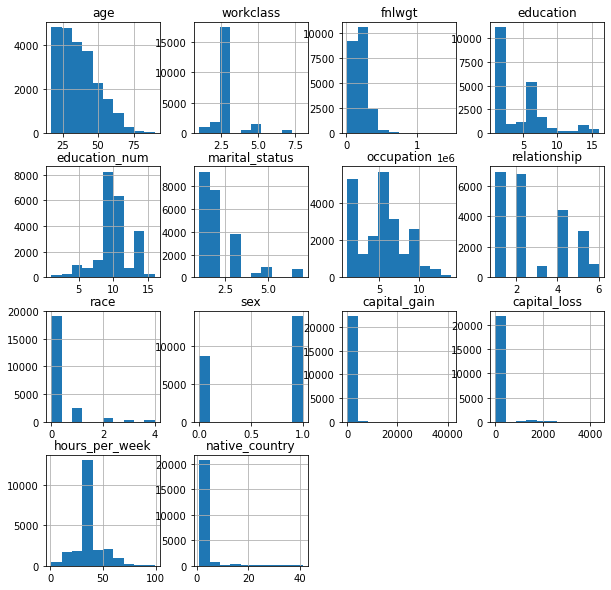

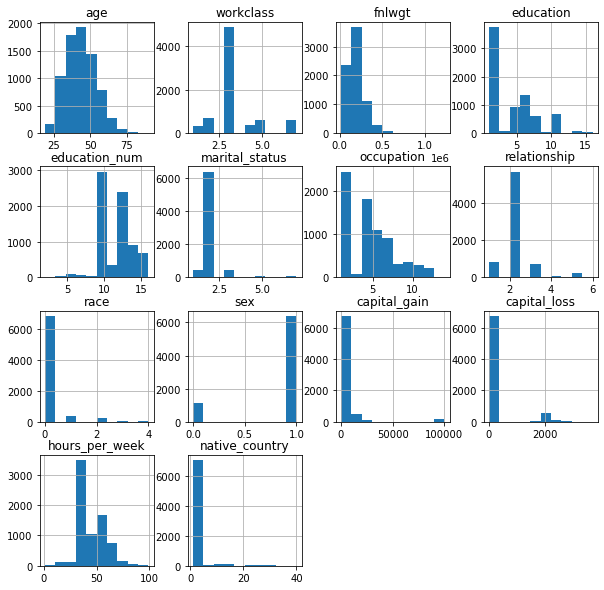

In [21]:
data.groupby('income').hist(figsize=(10,10))

### Train Data

In [22]:
#Splitting the Train Input and Output Data
#Take all the 9 features as input X and value 'income' as output Y.
X = data.drop(axis=0, columns=['income'])
Y = data['income'].values

In [24]:
X

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39,1,77516,1,13,1,1,1,0,1,2174,0,40,1
1,50,2,83311,1,13,2,2,2,0,1,0,0,13,1
2,38,3,215646,2,9,3,3,1,0,1,0,0,40,1
3,53,3,234721,3,7,2,3,2,1,1,0,0,40,1
4,28,3,338409,1,13,2,4,3,1,0,0,0,40,2
5,37,3,284582,4,14,2,2,3,0,0,0,0,40,1
6,49,3,160187,5,5,4,5,1,1,0,0,0,16,3
7,52,2,209642,2,9,2,2,2,0,1,0,0,45,1
8,31,3,45781,4,14,1,4,1,0,0,14084,0,50,1
9,42,3,159449,1,13,2,2,2,0,1,5178,0,40,1


In [25]:
#Scaling Data Input
scaler = preprocessing.MinMaxScaler()
X = scaler.fit_transform(X)

In [26]:
#Splitting into Data Training and Data Test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.33, random_state=24)

In [27]:
#Importing Library for Accuracy Meassurement
from sklearn.metrics import accuracy_score

In [28]:
from sklearn.naive_bayes import GaussianNB
nb = GaussianNB()
nb.fit(X_train, y_train)
y_pred_nb= nb.predict(X_test)
accuracy_score(y_test,y_pred_nb)

0.7978702029334941

In [34]:
from sklearn import tree
clf = tree.DecisionTreeClassifier(class_weight = None, min_samples_leaf = 100, random_state = 10)
clf.fit(X_train, y_train)
y_pred_clf= clf.predict(X_test)
accuracy_score(y_test,y_pred_clf)

0.8466947960618847

### Evaluation

In [31]:
def confusion_metrics (y_test,y_pred):
    #Showing Confusion Matrix to know True Positive, False Positive, True Negative and False Negative
    from sklearn import metrics
    cm = metrics.confusion_matrix(y_test, y_pred)

    cm_df = pd.DataFrame(cm, 
                         columns = ['Predicted Negative', 'Predicted Positive'], 
                         index = ['Actual Negative', 'Actual Positive'])

    #Assign True Positive, False Positive, True Negative and False Negative intu variable
    TN = cm_df.loc['Actual Negative','Predicted Negative']
    FN = cm_df.loc['Actual Positive','Predicted Negative']
    FP = cm_df.loc['Actual Negative','Predicted Positive']
    TP = cm_df.loc['Actual Positive','Predicted Positive']
    
    print('True Negative  : ',TN)
    print('False Negative : ',FN)
    print('False Positive : ',FP)
    print('True Positive  : ',TP)
    print('')
    #Find Precision, Recall, and F1-Score
    from sklearn.metrics import classification_report
    print(classification_report(y_test,y_pred))

In [32]:
#Evaluating for Naive Bayes
confusion_metrics(y_test,y_pred_nb)

True Negative  :  7036
False Negative :  1531
False Positive :  481
True Positive  :  906

              precision    recall  f1-score   support

           0       0.82      0.94      0.87      7517
           1       0.65      0.37      0.47      2437

    accuracy                           0.80      9954
   macro avg       0.74      0.65      0.67      9954
weighted avg       0.78      0.80      0.78      9954



In [33]:
#Evaluating for Decision Tree
confusion_metrics(y_test,y_pred_clf)

True Negative  :  6487
False Negative :  902
False Positive :  1030
True Positive  :  1535

              precision    recall  f1-score   support

           0       0.88      0.86      0.87      7517
           1       0.60      0.63      0.61      2437

    accuracy                           0.81      9954
   macro avg       0.74      0.75      0.74      9954
weighted avg       0.81      0.81      0.81      9954

